In [ ]:
!pip install transformer_lens

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.2/189.2 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 739.7/739.7 kB 24.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.4/55.4 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 104.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 77.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
 

In [ ]:
# Import the drive module


# Mount your Google Drive to the Colab environment
# Follow the instructions in the output to authorize access.


# You should see "Mounted at /content/drive" once successful.

IndentationError: expected an indented block after 'for' statement on line 181 (<ipython-input-7-8731e5fa246d>, line 182)

In [ ]:
# prompt: can you fix the indentation error listed here:  File "<ipython-input-7-8731e5fa246d>", line 182
#     G.add_node(i, label=label)
#     ^
# IndentationError: expected an indented block after 'for' statement on line 181

from google.colab import drive
!pip install transformer_lens
# Import the drive module

# Mount your Google Drive to the Colab environment
# Follow the instructions in the output to authorize access.
drive.mount('/content/drive')

# You should see "Mounted at /content/drive" once successful.





Generating Attention Graphs for each head and layer...


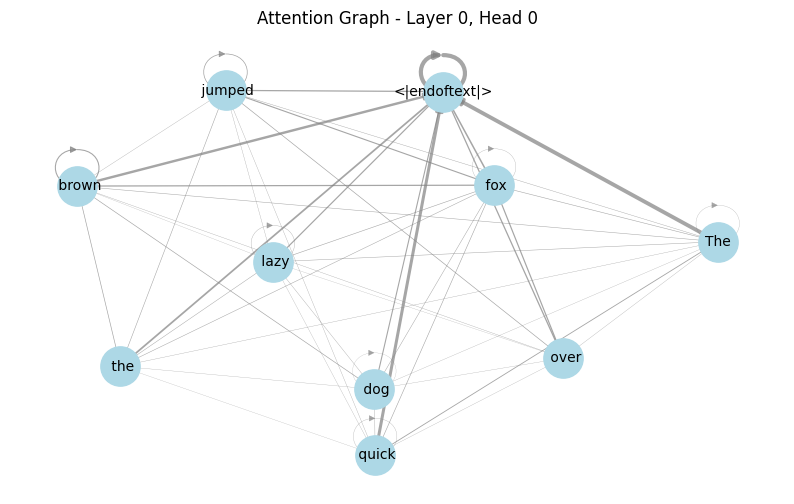

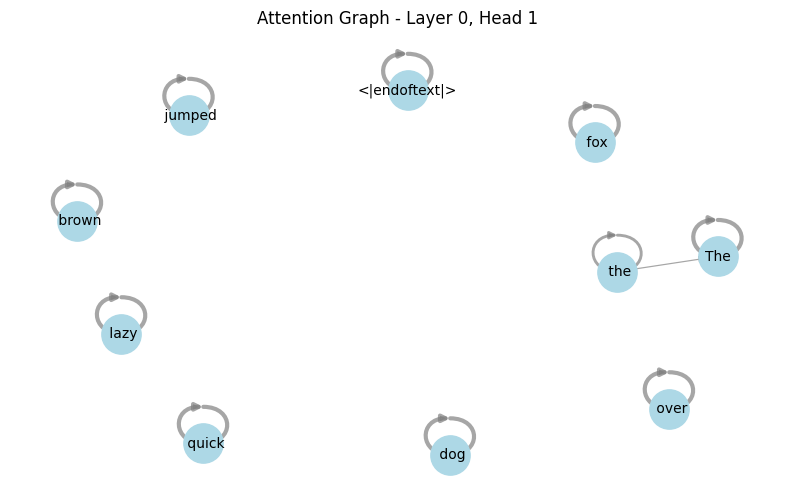

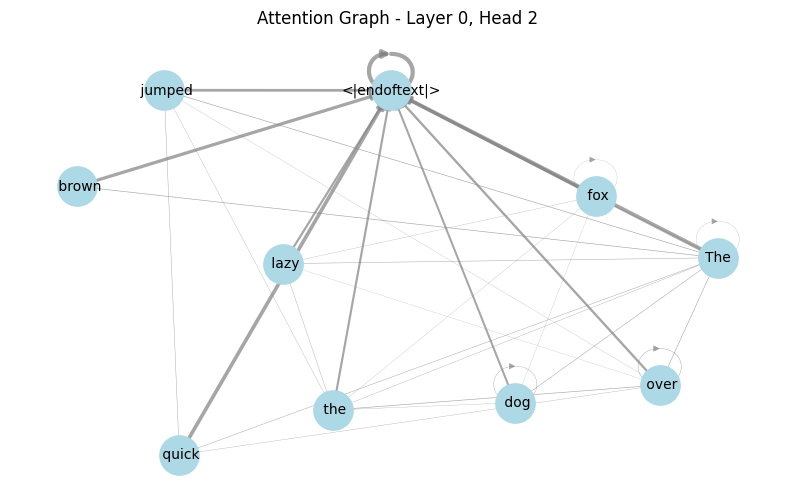

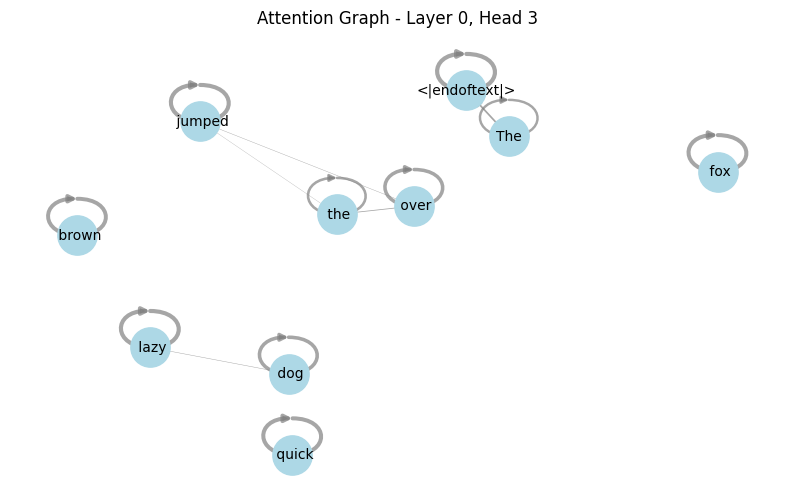

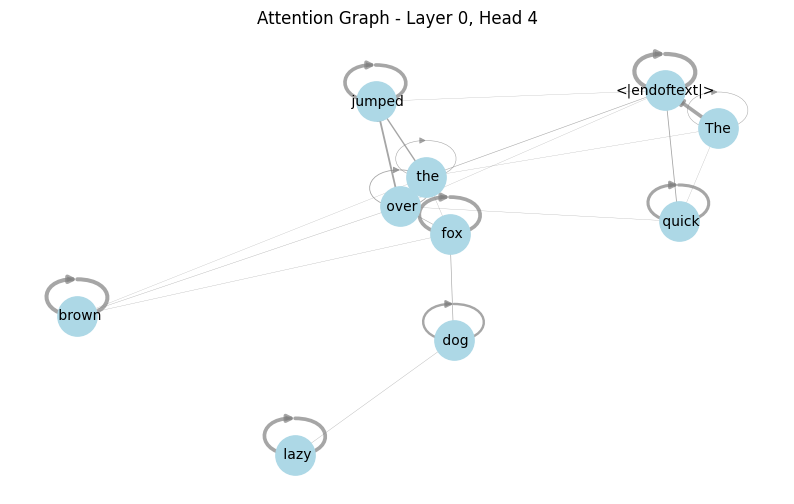

...

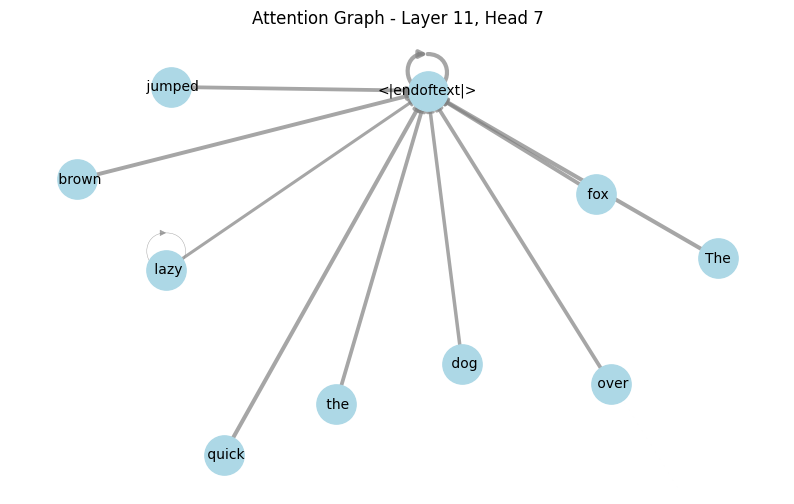

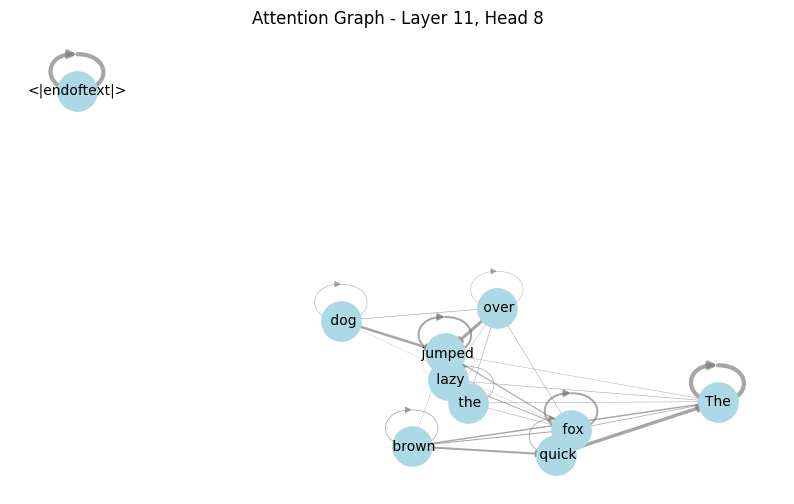

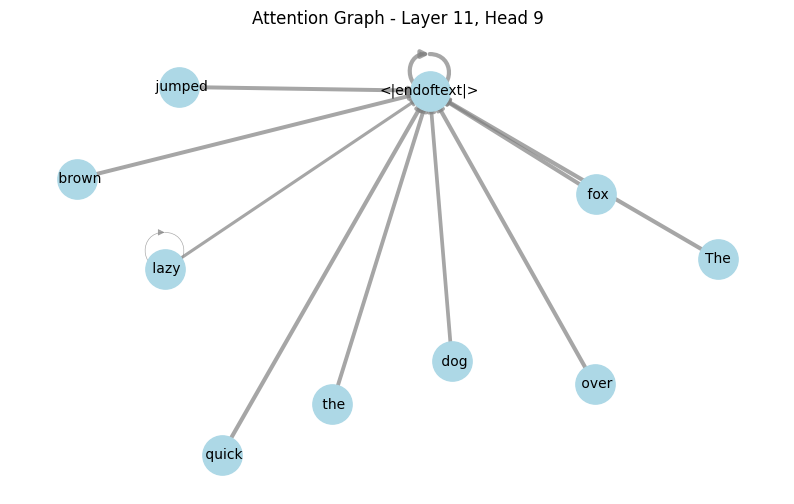

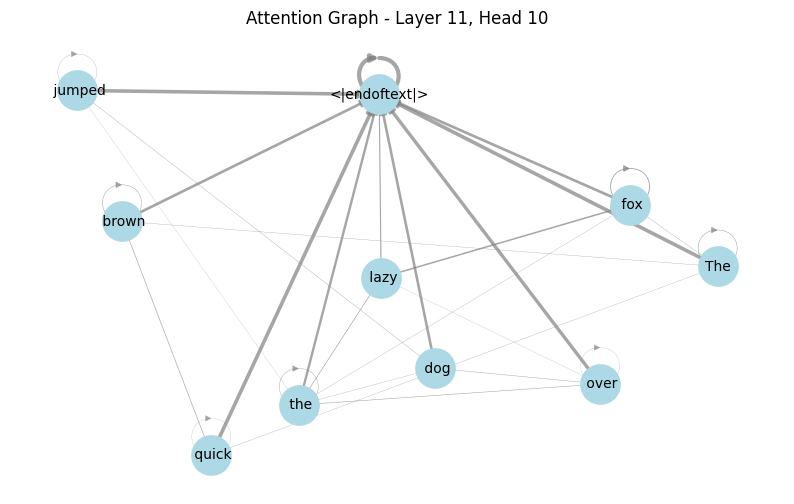

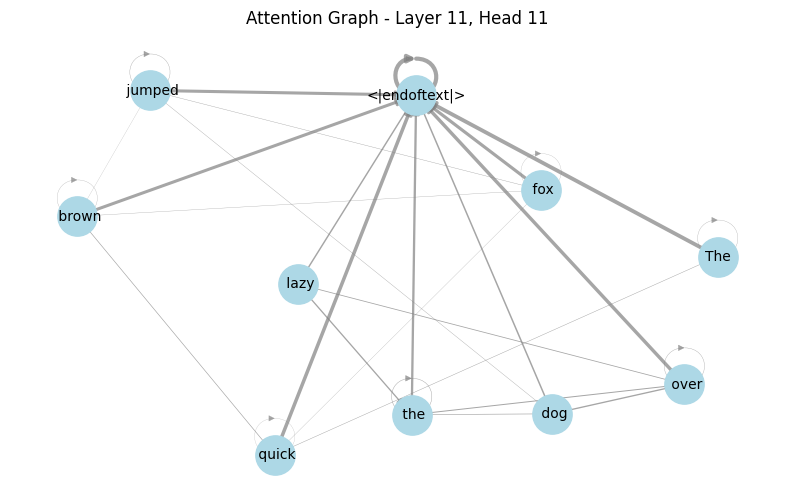


Generating Attention Maps (Heatmaps) for all heads and layers...


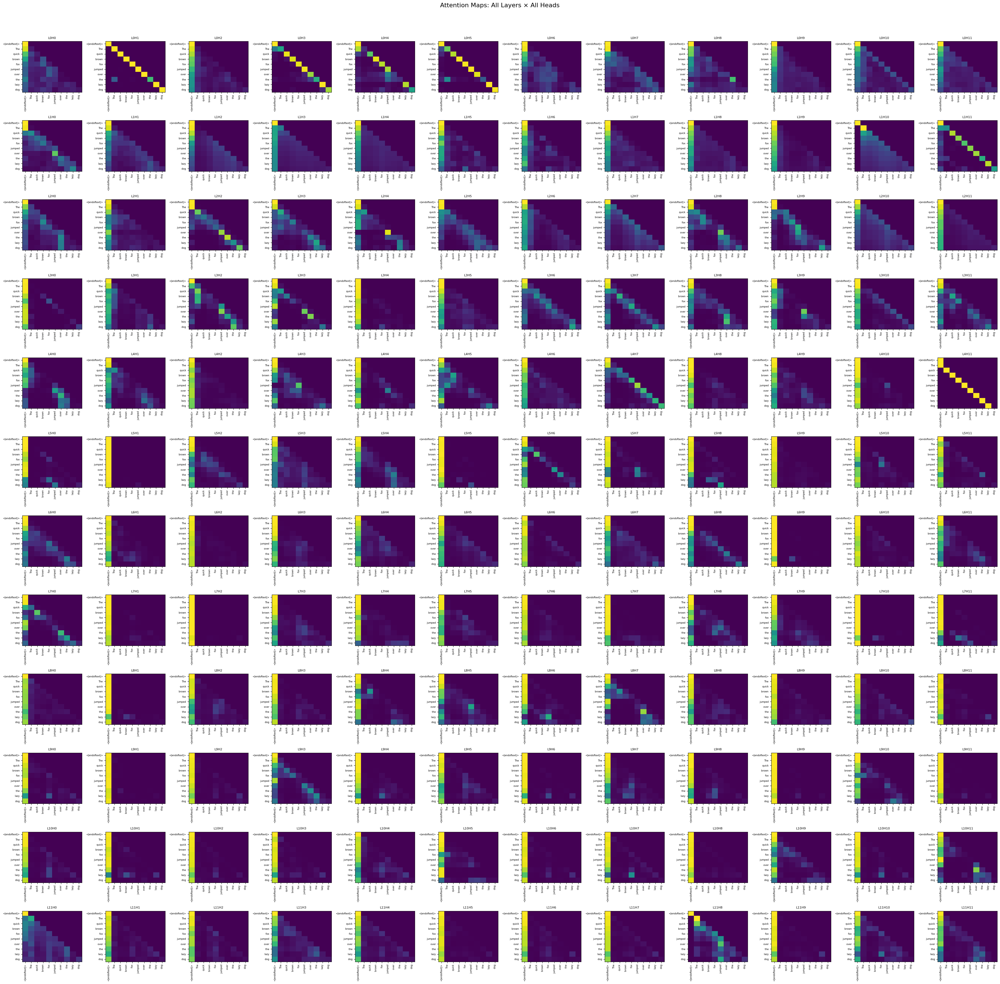

Heatmap figure saved to: /content/drive/My Drive/COLAB_AI_FOLDER/all_attention_maps.png

Generating Semantic Networks for each head with multiple foci...
' truth' not found in tokens. Cannot use it as a focus.
' hurting' not found in tokens. Cannot use it as a focus.
' love' not found in tokens. Cannot use it as a focus.


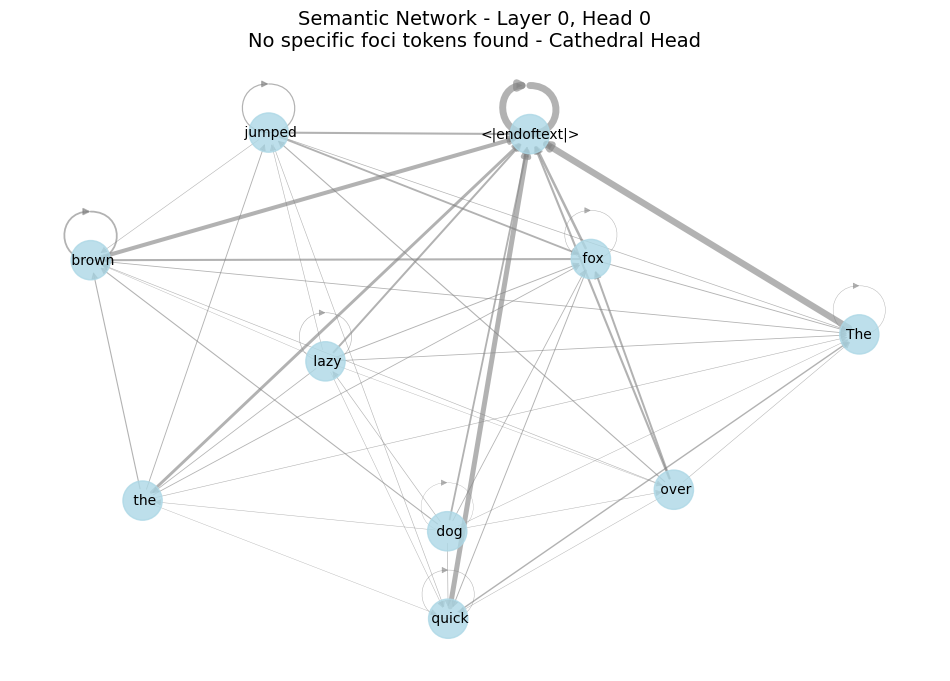

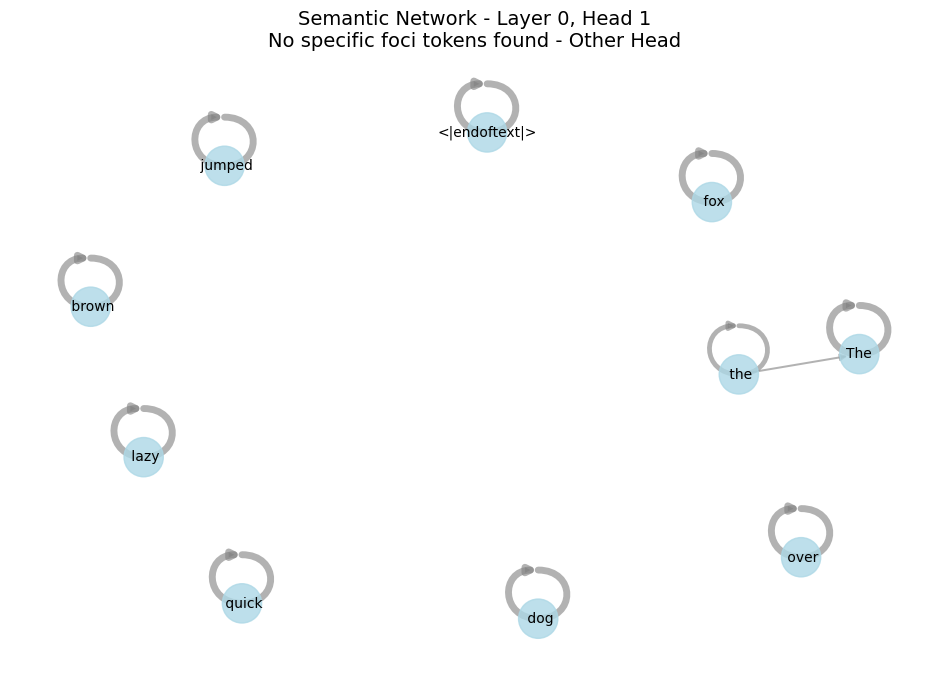

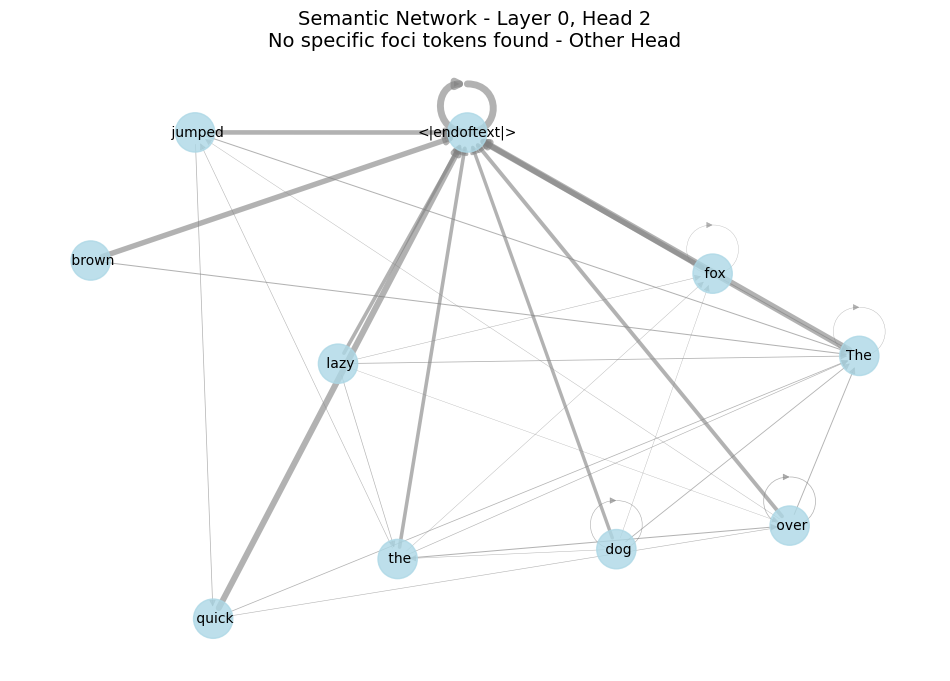

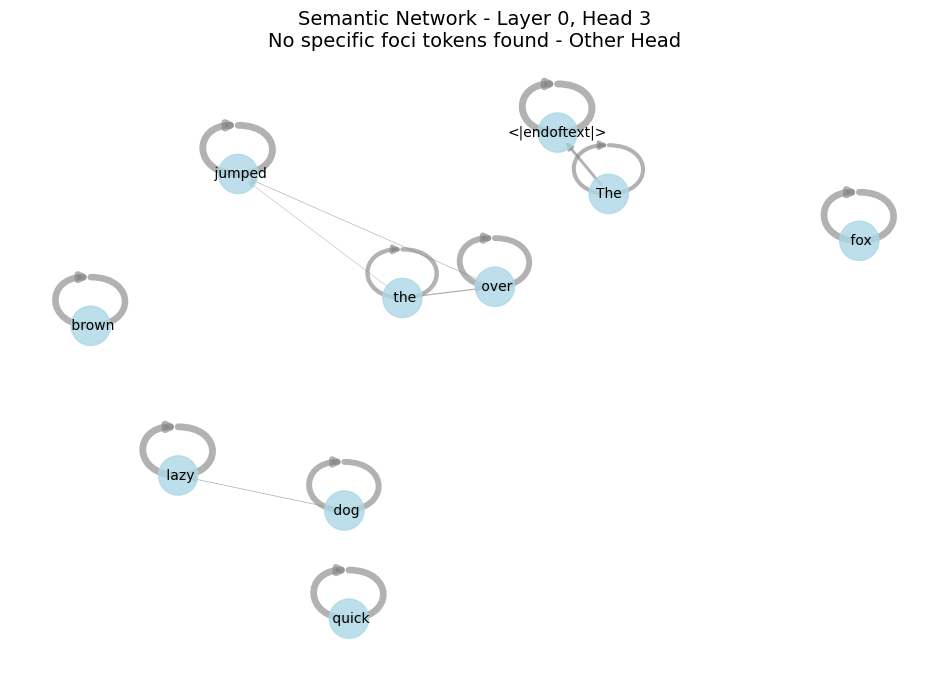

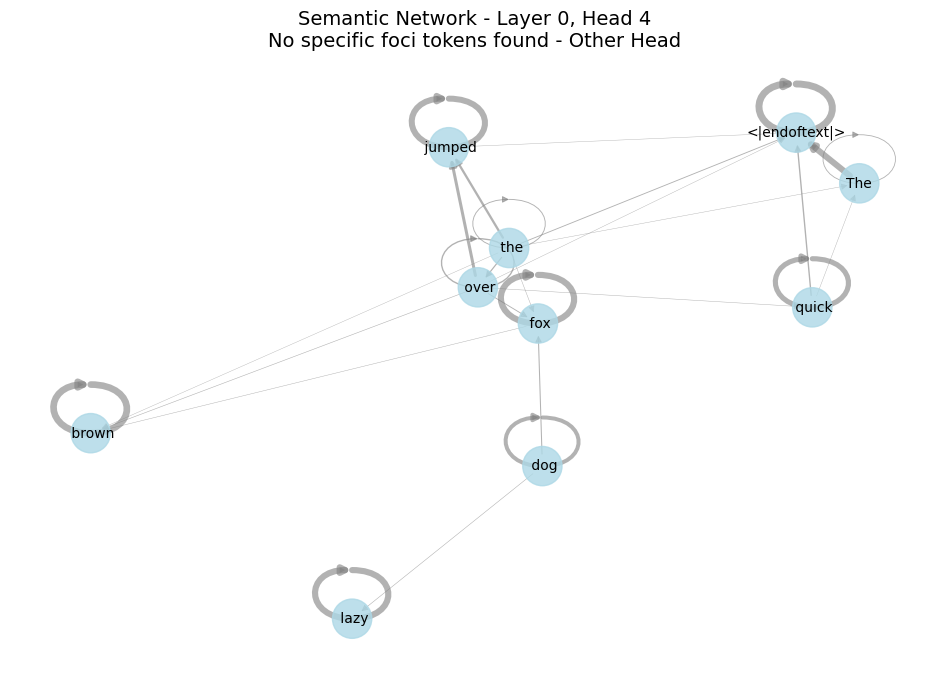

...

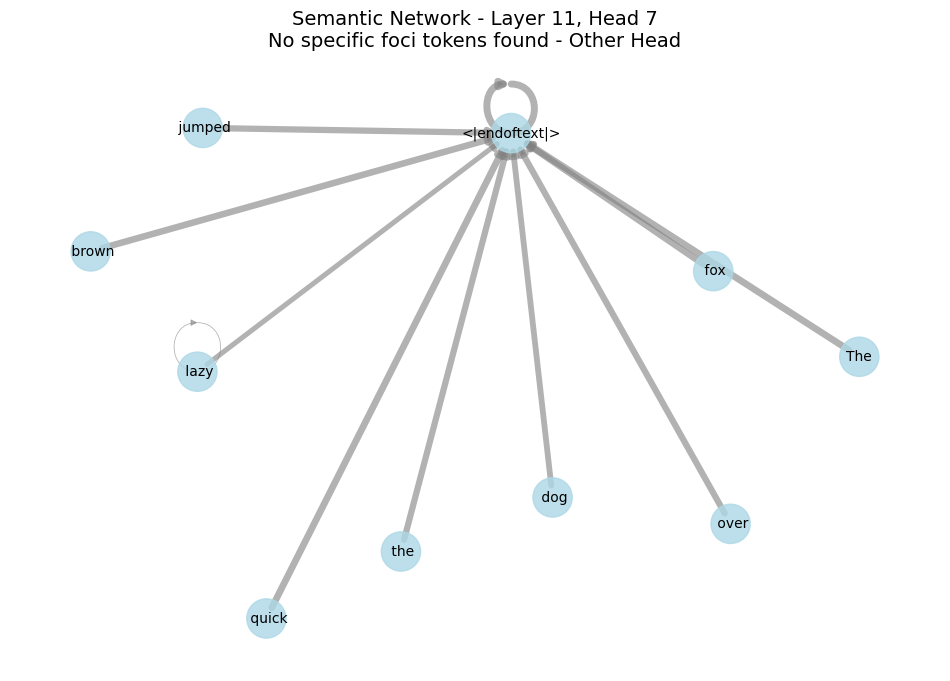

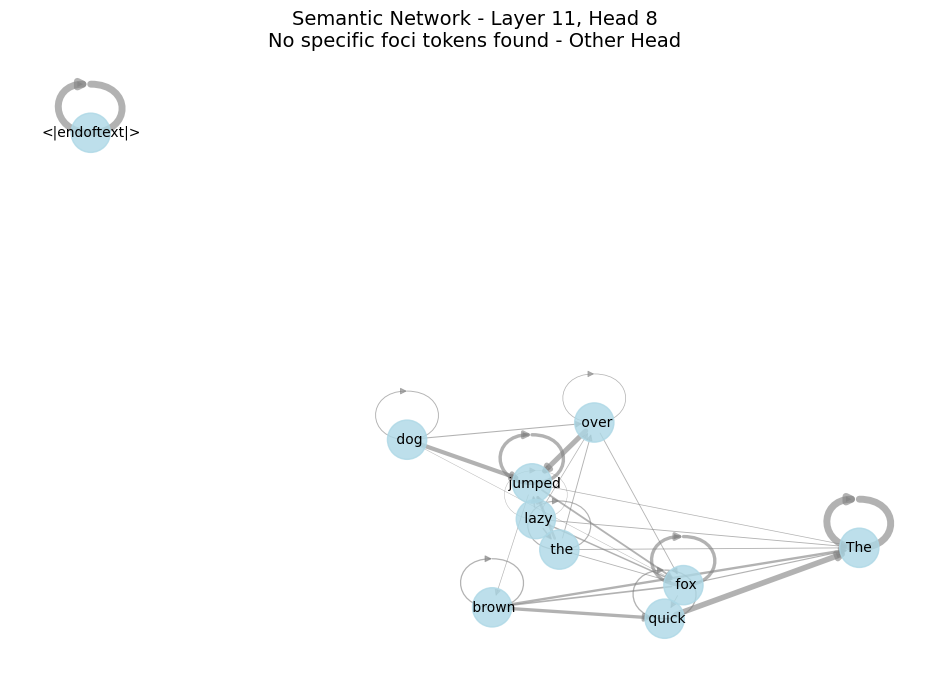

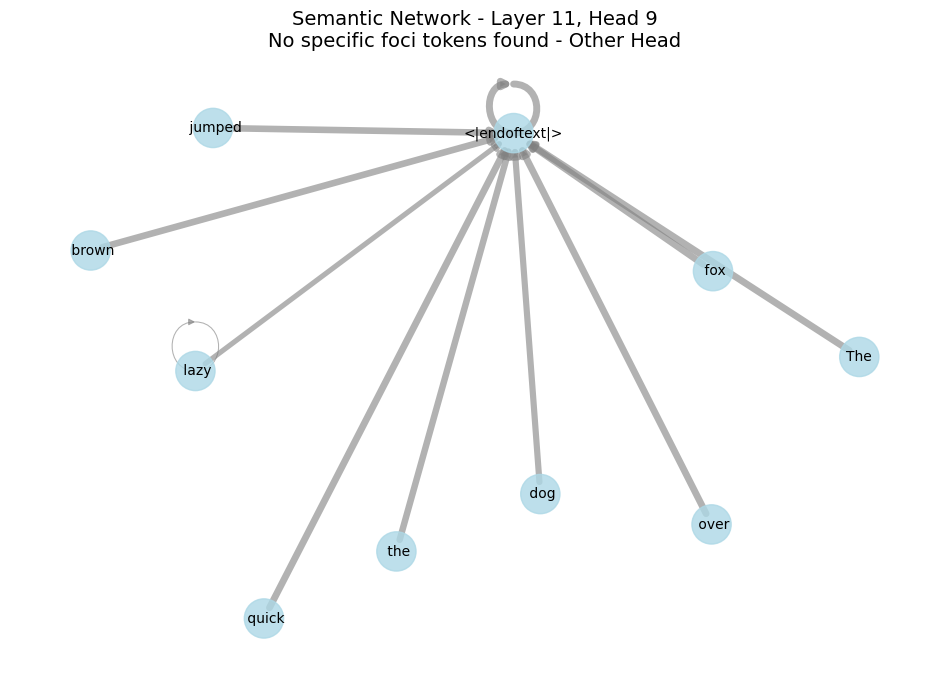

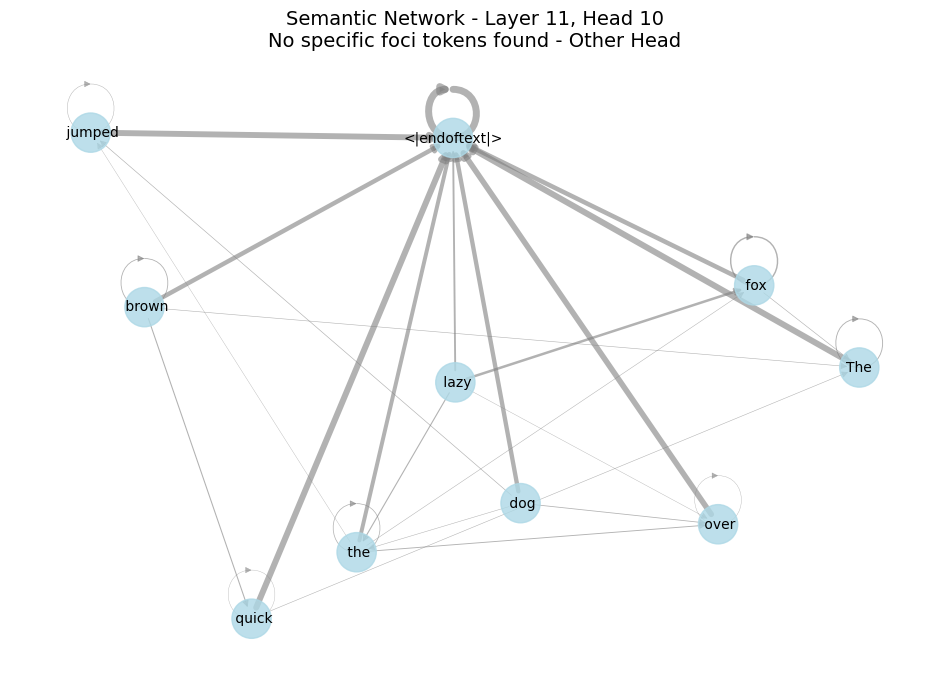

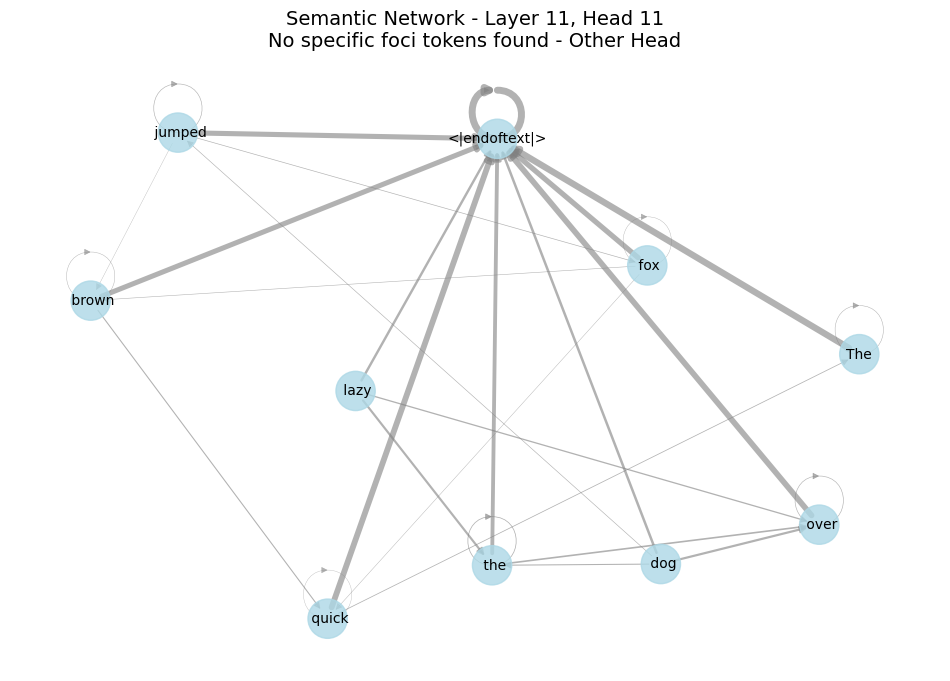


Analysis and plotting complete. Check your Google Drive folder for saved files.


In [ ]:
# @title Define Plotting Functions (Colab section title, code below is active)

# This function is NOT commented out
def plot_attention_graph(attn_matrix, token_labels, threshold=0.05, layer=0, head=0):
    """
    Plots a standard attention graph for a single head and saves it to Drive.
    """
    G = nx.DiGraph()
    num_tokens = len(token_labels)

    for i, label in enumerate(token_labels):
        # This line was missing indentation
        G.add_node(i, label=label)

    for src in range(num_tokens):
        for tgt in range(num_tokens):
            weight = attn_matrix[src, tgt].item()
            if weight > threshold:
                G.add_edge(src, tgt, weight=weight)

    pos = nx.spring_layout(G, seed=42)

    # Create the figure
    plt.figure(figsize=(10, 6))
    nx.draw_networkx_nodes(G, pos, node_color='lightblue', node_size=800)
    nx.draw_networkx_labels(G, pos, labels={i: token_labels[i] for i in G.nodes}, font_size=10)

    edges = G.edges()
    weights = [G[u][v]['weight'] for u, v in edges]
    widths = [3 * w for w in weights]
    nx.draw_networkx_edges(G, pos, edgelist=edges, width=widths, arrows=True, edge_color="gray", alpha=0.7)

    plt.title(f"Attention Graph - Layer {layer}, Head {head}")
    plt.axis('off')

    # --- Saving this plot to your Drive folder ---
    # SAVING MUST HAPPEN BEFORE plt.show() and plt.close()
    plot_filename = f'attn_graph_L{layer}H{head}.png'
    plot_subfolder = os.path.join(drive_project_folder, 'Attention_Graphs')
    plot_save_path = os.path.join(plot_subfolder, plot_filename) # Save in a subfolder for organization

    try:
        plt.savefig(plot_save_path, bbox_inches='tight')
        # print(f"Plot saved to: {plot_save_path}") # Optional: print for each plot
    except Exception as e:
        print(f"Error saving plot L{layer}H{head} to Drive at {plot_save_path}: {e}")
    # --- End Saving ---

    # Now display and close the figure
    plt.show() # Display after saving
    plt.close() # Close the figure after saving and showing to free up memory


# This function is NOT commented out
def plot_attention_graph_with_focus(attn_matrix, token_labels, threshold=0.05, layer=0, head=0, foci_indices=[], is_cathedral=False):
    """
    Plots an attention graph for a single head, highlighting tokens attended by specified foci tokens, and saves it to Drive.
    """
    G = nx.DiGraph()
    num_tokens = len(token_labels)

    for i, label in enumerate(token_labels):
        # This line was missing indentation
        G.add_node(i, label=label)

    for src in range(num_tokens):
        for tgt in range(num_tokens):
            weight = attn_matrix[src, tgt].item()
            if weight > threshold:
                G.add_edge(src, tgt, weight=weight)

    node_colors = ['lightblue'] * num_tokens
    highlighted_nodes = set()

    if foci_indices:
        for focus_index in foci_indices:
            if focus_index != -1 and focus_index < num_tokens:
                attention_from_focus = attn_matrix[focus_index].numpy()
                for i in range(num_tokens):
                    if attention_from_focus[i] > threshold:
                        if i not in highlighted_nodes:
                             node_colors[i] = 'salmon'
                             highlighted_nodes.add(i)

            for focus_index in foci_indices:
                if focus_index != -1 and focus_index < num_tokens:
                    node_colors[focus_index] = 'gold'


    pos = nx.spring_layout(G, seed=42)

    # Create the figure
    plt.figure(figsize=(12, 8))
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=800, alpha=0.8)
    nx.draw_networkx_labels(G, pos, labels={i: token_labels[i] for i in G.nodes}, font_size=10)

    edges = G.edges()
    weights = [G[u][v]['weight'] for u, v in edges]
    widths = [5 * w for w in weights]
    nx.draw_networkx_edges(G, pos, edgelist=edges, width=widths, arrows=True, edge_color="gray", alpha=0.6)

    focus_labels = [token_labels[i] for i in foci_indices if i != -1 and i < num_tokens]
    focus_desc = f"Foci: {', '.join(focus_labels)}" if focus_labels else "No specific foci tokens found"
    head_type_desc = "Cathedral Head" if is_cathedral else "Other Head"

    plt.title(f"Semantic Network - Layer {layer}, Head {head}\n{focus_desc} - {head_type_desc}", fontsize=14)
    plt.axis('off')

    # --- Saving this plot to your Drive folder ---
    # SAVING MUST HAPPEN BEFORE plt.show() and plt.close()
    plot_filename = f'semantic_network_L{layer}H{head}.png'
    plot_subfolder = os.path.join(drive_project_folder, 'Semantic_Networks')
    plot_save_path = os.path.join(plot_subfolder, plot_filename) # Save in a subfolder for organization
    try:
        plt.savefig(plot_save_path, bbox_inches='tight')
        # print(f"Plot saved to: {plot_save_path}") # Optional: print for each plot
    except Exception as e:
        print(f"Error saving plot L{layer}H{head} to Drive at {plot_save_path}: {e}")
    # --- End Saving ---

    # Now display and close the figure
    plt.show() # Display after saving
    plt.close() # Close the figure after saving and showing


# @title Generate and Save Plots (Colab section title, code below is active)

# Plot attention graphs for each head and layer
print("\nGenerating Attention Graphs for each head and layer...")
# These lines are NOT commented out
num_layers = model.cfg.n_layers
num_heads = model.cfg.n_heads

for layer in range(num_layers):
    for head in range(num_heads):
        try: # This try block is NOT commented out
            # Access attention matrix from cache
            attn_matrix = cache[f"blocks.{layer}.attn.hook_pattern"][0][head].detach().cpu()
            # Calling the function which now includes saving
            plot_attention_graph(attn_matrix, token_strs, threshold=0.05, layer=layer, head=head) # This line is NOT commented out
        except Exception as e: # This except block is NOT commented out
            print(f"Error plotting Attention Graph for Layer {layer}, Head {head}: {e}") # This line is NOT commented out


# Plot attention maps (heatmaps) for all heads and layers
print("\nGenerating Attention Maps (Heatmaps) for all heads and layers...")
# These lines are NOT commented out
num_layers = model.cfg.n_layers
num_heads = model.cfg.n_heads
num_tokens = tokens.shape[-1]

fig, axes = plt.subplots(num_layers, num_heads, figsize=(3 * num_heads, 3 * num_layers)) # This line is NOT commented out
fig.suptitle("Attention Maps: All Layers × All Heads", fontsize=16) # This line is NOT commented out

for layer in range(num_layers): # This line is NOT commented out
    try: # This try block is NOT commented out
        # Access attention patterns directly from the cache object
        attn_layer = cache[f"blocks.{layer}.attn.hook_pattern"][0] # shape: [num_heads, seq_len, seq_len] # This line is NOT commented out
        for head in range(num_heads): # This line is NOT commented out
            ax = axes[layer, head] # This line is NOT commented out
            attn = attn_layer[head].detach().cpu() # This line is NOT commented out
            im = ax.imshow(attn, cmap="viridis", aspect="auto") # This line is NOT commented out
            ax.set_xticks(range(num_tokens)) # This line is NOT commented out
            ax.set_yticks(range(num_tokens)) # This line is NOT commented out
            ax.set_xticklabels(token_strs, rotation=90) # This line is NOT commented out
            ax.set_yticklabels(token_strs) # This line is NOT commented out
            ax.set_title(f"L{layer}H{head}", fontsize=8) # This line is NOT commented out
            ax.tick_params(labelsize=6) # This line is NOT commented out
    except Exception as e: # This except block is NOT commented out
        print(f"Error plotting Attention Maps for Layer {layer}: {e}") # This line is NOT commented out

fig.tight_layout(rect=[0, 0, 1, 0.96]) # This line is NOT commented out
plt.show() # This line is NOT commented out # Display the plot in the notebook

# --- Saving this figure to your mounted Drive ---
# These lines are NOT commented out
heatmap_filename = 'all_attention_maps.png' # This line is NOT commented out
heatmap_save_path = f'{drive_project_folder}{heatmap_filename}' # This line is NOT commented out
try: # This try block is NOT commented out
    fig.savefig(heatmap_save_path, bbox_inches='tight') # This line is NOT commented out
    print(f"Heatmap figure saved to: {heatmap_save_path}") # This line is NOT commented out
except Exception as e: # This except block is NOT commented out
    print(f"Error saving heatmap figure to Drive at {heatmap_save_path}: {e}") # This line is NOT commented out
plt.close(fig) # This line is NOT commented out # Close the figure after saving


# Generate and plot semantic networks for each head with multiple foci
print("\nGenerating Semantic Networks for each head with multiple foci...")

# Define foci tokens and get their indices
foci_tokens_list = [" test1", " test2", " test3"] # Add other foci tokens here # This line is NOT commented out
# These lines are NOT commented out
foci_indices = []
for focus_token in foci_tokens_list:
    try:
        # Ensure token exists before getting index
        if focus_token in token_strs:
            foci_indices.append(token_strs.index(focus_token))
        else:
             print(f"'{focus_token}' not found in tokens. Cannot use it as a focus.")
             foci_indices.append(-1) # Add sentinel if not found
    except Exception as e:
        print(f"Error finding index for '{focus_token}': {e}")
        foci_indices.append(-1)


# Example of 'cathedral' heads (placeholders)
# Replace with indices of heads identified as 'cathedral' based on research or analysis.
# This line is NOT commented out
cathedral_heads_example = [(0, 0), (1, 5), (3, 3)] # Example: Layer 0 Head 0, Layer 1 Head 5, Layer 3 Head 3

# These lines are NOT commented out
num_layers = model.cfg.n_layers
num_heads = model.cfg.n_heads

# Generate and plot a semantic network for each head
for layer in range(num_layers): # This line is NOT commented out
    for head in range(num_heads): # This line is NOT commented out
        try: # This try block is NOT commented out
            # Access attention matrix from cache
            attn_matrix = cache[f"blocks.{layer}.attn.hook_pattern"][0][head].detach().cpu() # This line is NOT commented out
            is_cathedral_head = (layer, head) in cathedral_heads_example # This line is NOT commented out
            # Pass only the valid foci indices to the plotting function
            valid_foci_indices = [idx for idx in foci_indices if idx != -1] # This line is NOT commented out
            # Calling the function which now includes saving
            plot_attention_graph_with_focus(attn_matrix, token_strs, threshold=0.05, layer=layer, head=head, foci_indices=valid_foci_indices, is_cathedral=is_cathedral_head) # This line is NOT commented out
        except Exception as e: # This except block is NOT commented out
            print(f"Error plotting Semantic Network for Layer {layer}, Head {head}: {e}") # This line is NOT commented out


# @title Combined Semantic Network (Optional) (Colab section title, code below is optional and commented out)
# If you want to see a single network combining attention from all heads/layers
# Uncomment the code below. This part is computationally more intensive
# as it considers all connections above a threshold from all heads.

# print("\nGenerating Combined Semantic Network...") # This line is commented out
# try: # This try block is commented out
#     def build_combined_semantic_network(token_strs, attention_patterns, threshold=0.01, foci_tokens=[]): # This function definition is commented out
#         G = nx.DiGraph() # This line is commented out
#         num_tokens = len(token_strs) # This line is commented out

#         foci_indices_combined = [] # This line is commented out
#         for focus_token in foci_tokens: # This loop is commented out
#             try: # This try block is commented out
#                 if focus_token in token_strs: # This line is commented out
#                     foci_indices_combined.append(token_strs.index(focus_token)) # This line is commented out
#                 else: # This else block is commented out
#                     print(f"'{focus_token}' not found in tokens for combined network. Skipping.") # This line is commented out
#                     foci_indices_combined.append(-1) # Add sentinel if not found # This line is commented out
#             except Exception as e: # This except block is commented out
#                  print(f"Error finding index for '{focus_token}' for combined network: {e}") # This line is commented out
#                  foci_indices_combined.append(-1) # This line is commented out

#         for i, label in enumerate(token_strs): # This loop is commented out
#             G.add_node(i, label=label) # This line is commented out

#         all_edges_with_weights = {} # This line is commented out
#         num_layers = model.cfg.n_layers # This line is commented out
#         num_heads = model.cfg.n_heads # This line is commented out

#         for layer in range(num_layers): # This loop is commented out
#             attn_layer = attention_patterns[f"blocks.{layer}.attn.hook_pattern"][0] # This line is commented out
#             for head in range(num_heads): # This loop is commented out
#                 attn_matrix = attn_layer[head].detach().cpu() # This line is commented out
#                 for src in range(num_tokens): # This loop is commented out
#                     for tgt in range(num_tokens): # This loop is commented out
#                         weight = attn_matrix[src, tgt].item() # This line is commented out
#                         if weight > threshold: # This line is commented out
#                             edge = (src, tgt) # This line is commented out
#                             if edge not in all_edges_with_weights or weight > all_edges_with_weights[edge]: # This line is commented out
#                                 all_edges_with_weights[edge] = weight # This line is commented out

#         for (src, tgt), weight in all_edges_with_weights.items(): # This loop is commented out
#             G.add_edge(src, tgt, weight=weight) # This line is commented out

#         node_colors = ['skyblue'] * num_tokens # This line is commented out
#         highlighted_nodes_combined = set() # This line is commented out

#         if foci_indices_combined: # This line is commented out
#             combined_attention_from_foci = np.zeros(num_tokens) # This line is commented out
#             valid_foci_count_combined = 0 # This line is commented out
#             for focus_index in foci_indices_combined: # This loop is commented out
#                 if focus_index != -1 and focus_index < num_tokens: # This line is commented out
#                      valid_foci_count_combined += 1 # This line is commented out
#                      for layer in range(num_layers): # This loop is commented out
#                         attn_layer = attention_patterns[f"blocks.{layer}.attn.hook_pattern"][0] # This line is commented out
#                         for head in range(num_heads): # This loop is commented out
#                             attn_matrix = attn_layer[head].detach().cpu() # This line is commented out
#                             combined_attention_from_foci += attn_matrix[:, focus_index].numpy() # This line is commented out

#             if valid_foci_count_combined > 0 and combined_attention_from_foci.max() > 0: # This line is commented out
#                 combined_attention_from_foci /= combined_attention_from_foci.max() # This line is commented out

#             combined_threshold_for_coloring = threshold # You might need to adjust this threshold for the combined view # This line is commented out

#             for i in range(num_tokens): # This loop is commented out
#                 # Check if the combined attention from any focus token is above a threshold
#                 # This coloring logic might need adjustment based on desired visualization
#                 # A simpler approach might be to color nodes with high incoming attention regardless of focus
#                 # For now, sticking to the combined attention from foci logic, adjusting the threshold
#                 if combined_attention_from_foci[i] > combined_threshold_for_coloring: # This line is commented out
#                     if i not in highlighted_nodes_combined: # This line is commented out
#                          node_colors[i] = 'salmon' # This line is commented out
#                          highlighted_nodes_combined.add(i) # This line is commented out

#             for focus_index in foci_indices_combined: # This loop is commented out
#                 if focus_index != -1 and focus_index < num_tokens: # This line is commented out
#                     node_colors[focus_index] = 'gold' # This line is commented out

#         pos = nx.spring_layout(G, seed=42) # This line is commented out

#         plt.figure(figsize=(15, 10)) # This line is commented out
#         nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=800, alpha=0.8) # This line is commented out
#         nx.draw_networkx_labels(G, pos, labels={i: token_strs[i] for i in G.nodes}, font_size=10) # This line is commented out

#         edges = G.edges() # This line is commented out
#         weights = [G[u][v]['weight'] for u, v in edges] # This line is commented out
#         widths = [5 * w for w in weights] # This line is commented out
#         nx.draw_networkx_edges(G, pos, edgelist=edges, width=widths, arrows=True, edge_color="gray", alpha=0.6) # This line is commented out

#         focus_labels = [token_strs[i] for i in foci_indices_combined if i != -1 and i < num_tokens] # This line is commented out
#         plt.title(f"Combined Semantic Network based on Attention Patterns (Foci: {', '.join(focus_labels)})", fontsize=16) # This line is commented out
#         plt.axis('off') # This line is commented out
#         plt.show() # This line is commented out # Display the plot in the notebook

#         # Example of saving this combined plot (optional)
#         # combined_plot_filename = 'combined_semantic_network.png' # This line is commented out
#         # combined_plot_save_path = f'{drive_project_folder}{combined_plot_filename}' # This line is commented out
#         # try: # This try block is commented out
#         #     plt.savefig(combined_plot_save_path, bbox_inches='tight') # This line is commented out
#         #     print(f"Combined plot saved to: {combined_plot_save_path}") # This line is commented out
#         # except Exception as e: # This except block is commented out
#         #     print(f"Error saving combined plot to Drive at {combined_plot_save_path}: {e}") # This line is commented out
#         # plt.close() # This line is commented out # Close the figure after saving


#     # Build and plot the combined semantic network using the cached attention patterns
#     # Pass the cache object which contains 'blocks.{layer}.attn.hook_pattern'
#     build_combined_semantic_network(token_strs, cache, threshold=0.01, foci_tokens=foci_tokens_list) # Adjust threshold as needed # This line is commented out
# except Exception as e: # This except block is commented out
#     print(f"Error generating Combined Semantic Network: {e}") # This line is commented out


print("\nAnalysis and plotting complete. Check your Google Drive folder for saved files.") # This line is NOT commented out